# Diabetes classification using sklearn

ดร.ไพรสันต์  ผดุงเวียง <br>
Dr.Praisan Padungweang

2024

# Outline

 เนื้อหา
* Data understanding
* Missing value
* Normailzation
* Classification
* GridsearchCV
* Pipeline
* Save and load model


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport
from summarytools import dfSummary

In [2]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import RobustScaler

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import joblib

In [4]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV

# Lab02
1. หาโมเดลที่ดีที่สุดสำหรับการทำนายลูกค้าย้ายค่าย
2. สร้าง pipeline แล้วบันทึกเพื่อการนำไปใช้งานได้สะดวก พร้อมทดลองใช้


In [5]:
# main_df_2 = pd.read_csv('https://github.com/praisan/hello-world/raw/master/churn_data.csv', delimiter=',')
# main_df_2.to_csv('churn_data.csv', index=False)

In [6]:
main_df_2 = pd.read_csv('churn_data.csv')

In [7]:
raw_data = main_df_2.drop(['AccountLength',	'State', 'AreaCode',	'Phone',], axis=1).copy()
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   VMailMessage   3333 non-null   int64  
 1   DayMins        3333 non-null   float64
 2   EveMins        3333 non-null   float64
 3   NightMins      3333 non-null   float64
 4   IntlMins       3333 non-null   float64
 5   CustServCalls  3333 non-null   int64  
 6   IntPlan        3333 non-null   int64  
 7   VMailPlan      3333 non-null   int64  
 8   DayCalls       3333 non-null   int64  
 9   DayCharge      3333 non-null   float64
 10  EveCalls       3333 non-null   int64  
 11  EveCharge      3333 non-null   float64
 12  NightCalls     3333 non-null   int64  
 13  NightCharge    3333 non-null   float64
 14  IntlCalls      3333 non-null   int64  
 15  IntlCharge     3333 non-null   float64
 16  Churn          3333 non-null   int64  
dtypes: float64(8), int64(9)
memory usage: 442.8 KB


In [8]:
raw_data.sample(3)

,VMailMessage,DayMins,EveMins,NightMins,IntlMins,CustServCalls,IntPlan,VMailPlan,DayCalls,DayCharge,EveCalls,EveCharge,NightCalls,NightCharge,IntlCalls,IntlCharge,Churn
2139,0,252.3,207.0,284.6,12.0,3,1,0,120,42.89,112,17.60,95,12.81,5,3.24,1
2900,0,108.6,209.9,222.6,7.9,1,0,0,108,18.46,126,17.84,117,10.02,5,2.13,1
222,0,136.1,272.9,220.2,4.4,1,0,0,112,23.14,96,23.20,104,9.91,2,1.19,0


In [9]:
dfSummary(raw_data)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,VMailMessage[int64],Mean (sd) : 8.1 (13.7)min < med < max:0.0 < 0.0 < 51.0IQR (CV) : 20.0 (0.6),46 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguNCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8fJSN1AAAACXBIWXMAAA9hAAAPYQGoP6dpAAAC0ElEQVR4nO3XvU/bQBiA8feSEF2+fMpHw8bSDaQOkViytyN/LGu3ImXoWoYumVhQhBUujYkby7hDaZdC4Wy1yYue3+z3zpEenS+mKAoB9l1t1y8AvETjuQeMMS0RaZZcf1sUxabkLPDbX0M1xrSGw+FZFEX9MouvVqulMeacWFHVcydqM4qi/nQ63Tjn0pCFvfd2Npv14zhuigihopJnP/0iIs65dDwe35VYv1ViBvgDf6agAqFCBUKFCoQKFQgVKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSoQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChAqFCBUKFCoQKFQgVKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSoQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChAqFCBUKFCoQKFQgVKhAqVCBUqECoUIFQoUJj1y/wGhljWiLSLDleE5H7Cttvi6LYVJjfS4T6hAqx2cFg8ME51wkdzPP8IEmSt91ud16r1bISe8tqtVoaY85fW6yE+ghjTGs4HJ5FUdQPnc2yzIrIyenp6efRaLQKmb26uupfXl6+mUwmXw8PD5ehe3vv7cXFxTiO45ExJmjvB3t7GhPq45pRFPWn0+nGOZeGDD7E1rbWZuPx+C5kdrlctkREOp1OGjorIpIkyUGWZe+Ojo7q9Xo96L1F9vs0frWhVrwnRvf39wfOuWXZ2HZhu902rLXtyWSShp7I3ns7m836cRw3RYRQQ+zinijy8/Od5/lJmqafRCT4ZNu1sidynueRiETGmLJb/7Orw4tC9d7b0IW99zbP84aU/+F2MBi8d851Qwd/3ROPj4+/9Hq9b6HzNzc3dj6ft733ncVisQ2ZXa/XVkQkSRK7WCza/2u26vz19XWvyrVBROT29nZtjPkoImXmvxdF8eTcDxZq5vaK7nyqAAAAAElFTkSuQmCC"">",0(0.0%)
2,DayMins[float64],Mean (sd) : 179.8 (54.5)min < med < max:0.0 < 179.4 < 350.8IQR (CV) : 72.7 (3.3),"1,667 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguNCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8fJSN1AAAACXBIWXMAAA9hAAAPYQGoP6dpAAACvklEQVR4nO3du47aQBSA4TNhIQNENjdBR0uxUgokGh4gZR42j5CCYkvEG9AhLgJBIBhwiijKRtqQtY2XOZP/62dx8QvtoJljE8exAK57d+8HAF7j4d4P4CNjTFlESimXH+M43t/yeXxAqH+RITbbaDQ+hWFYTfO5m81mZYz5Qqx/ItQXGGPKzWbzcxAE9aRroyiyIvI4GAyeWq3WJsna9XptR6NRfbFYlESEUJ8h1JeVgiCoD4fDfRiGhyQLp9NpfTKZVKy1Ubvd/pbis8sp1niPUK8Iw/CQNLbVakVoOWDXDxUIFSoQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgdNTjjmfz0URCYwxaf+ElzcECNUhu92uGEXRx263WygUConOwf7i6w0BQnXI8Xh8sNZW+v3+odPprJKu9/mGAKE6qFqtJj6w/YyXB7fZTEEFQoUKhAoVCBUqECpUIFSo4O3PUxnnPwWXy6V4y+dBNl6GmmUkj8jPsTzn8/nxcDh8FZG0v2fihrwMVTKM5BH5PZbndDoV8ng4JOdrqCKSbiSPCGN5XMRmCioQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChgtenp/5HGUcCOTsOiFA9knUkkMvjgAjVI1lGArk+DohQPZRhJJCzB8bZTEEFp79RM9wk5RapZ5wNNctNUm6R+sfZUCXDTVJukfrH5VBFJN1NUm6R+ofNFFQgVKhAqFCBUKECoUIFQoUKzv88hbfj8lsDcw2VYbp6uP7WwNxCZZiuLq6/NTDPb1SG6Srk6lsDc/8flWG6uAU2U7iZPO9r/TNUzoTiNfK+r3U11FucCZ3P509J14qIbLdbKyKy2+3sbDarvNXae3621ucWEVkulx+stZVer2dqtdr3JGv3+/378Xh8dSP2Ay96eOkidrdDAAAAAElFTkSuQmCC"">",0(0.0%)
3,EveMins[float64],Mean (sd) : 201.0 (50.7)min < med < max:0.0 < 201.4 < 363.7IQR (CV) : 68.7 (4.0),"1,611 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguNCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8fJSN1AAAACXBIWXMAAA9hAAAPYQGoP6dpAAACsUlEQVR4nO3du47aQBSA4TNh2TUX2SC00NFSRKKg5CHysHmEFDwAoqWis7gIBMHBGKeKlEhkE9sY5gz/14880v5bAOMzJk1TAWz36dEbAP7Hy6M34CJjTE1EXnMuP6VperzlflxAqDdmjKl1Op0vvu+386zf7XYbY8xXYv0Tod7eq+/77fF4fAyCIMqycLvdepPJpL1arV5FhFB/Q6glCYIg6na733Msrd18Mw7gwxRUIFSoQKhQgVChAqFCBUKFCoQKFQgVKhAqVCBUqMBPqH9R4ASUf7lcqrfez7Mj1CuKnICK49hLkuRzFEXfRCTPb/24glCvy30CarFYtGezWf18PlfyPDhJkqqI+MaYPMtFHD3PSqgfyHMCarPZ5D79dDgcqnEcD/v9fqVSqWT6B/nF1fOshGqR0+n04nlefTQaRb1eb5N1vcvnWQnVQo1GI+9ZVhFHz7Py9RRUIFSoQKhQgVChAqFCBUKFCoQKFQgVKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSoQKlQgVKhAqFCBUKECL/c5puBcAGtnAhCqQ4rOBbB5JgChOqTIXADbZwI4G2rBax5VDzorMBfA2pkAToZa9JpHBp3Zx8lQpcCQM5Hig85we66GKiL5r3ksMugM5eB7VKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChAqFCBUKFCk6fnkI2Nt/DanWoXEV+P7bfw2ptqFxFfl+238NqbajywKvIn5mt97DaHKqI3P8qctip1FCf+U3QZ1Tm8IvSQuVN0OdS9vCLf4ZqjPFE5C3rg0XEbzab78Ph8Fyr1X5kXbxcLr35fF7fbreNMAxPWdbu93tPRORwOHhhGNazPrvI+ketffSz1+t10/O8+mAwMK1WK9Pf+3g8vk2n0w8/iP0EwOhvbD9i16MAAAAASUVORK5CYII="">",0(0.0%)
4,NightMins[float64

In [10]:
profile = ProfileReport(raw_data, title="Profiling Report")

In [51]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
# prompt: drop vmail message and clean

raw_data = raw_data.drop(['VMailMessage'], axis=1)
raw_data['CustServCalls'] = raw_data['CustServCalls'].replace(0, np.nan)
col = raw_data.columns
imputer = SimpleImputer(strategy='most_frequent')
raw_data = imputer.fit_transform(raw_data)
clean_data = pd.DataFrame(raw_data, columns=col)


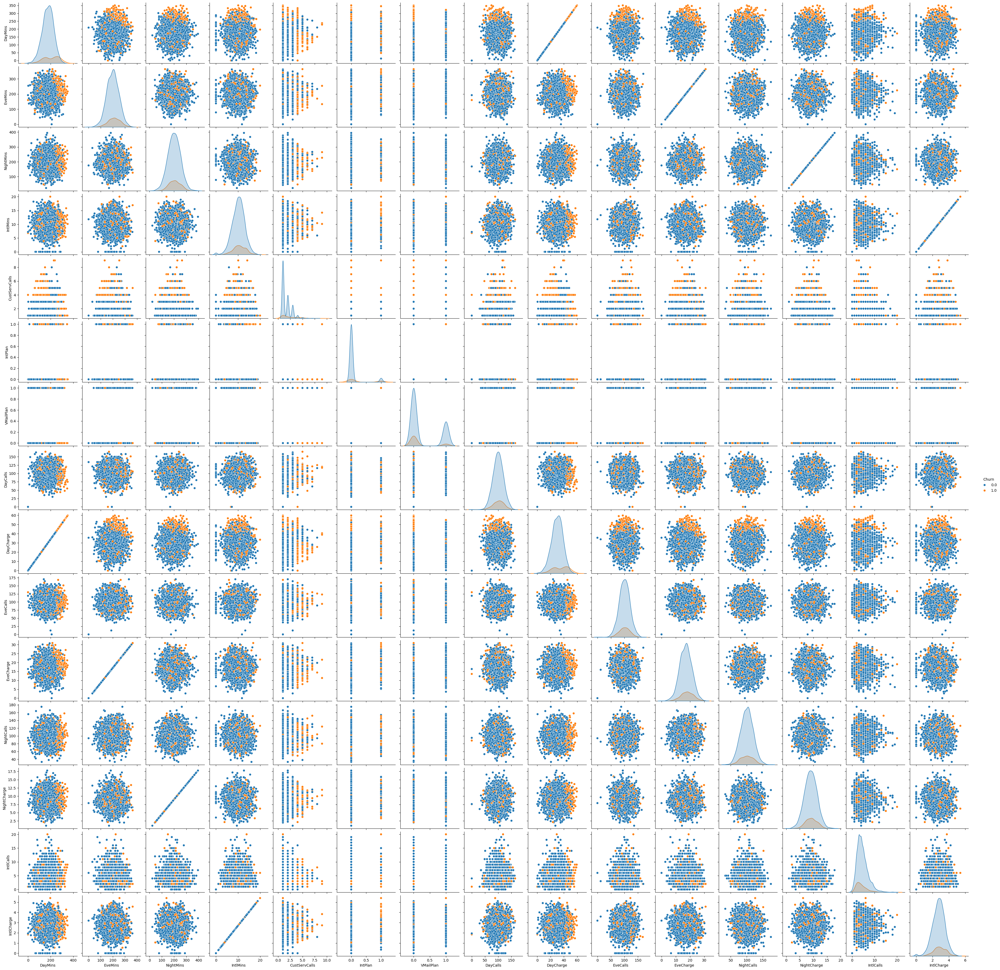

In [50]:
sns.pairplot(clean_data,hue= 'Churn')

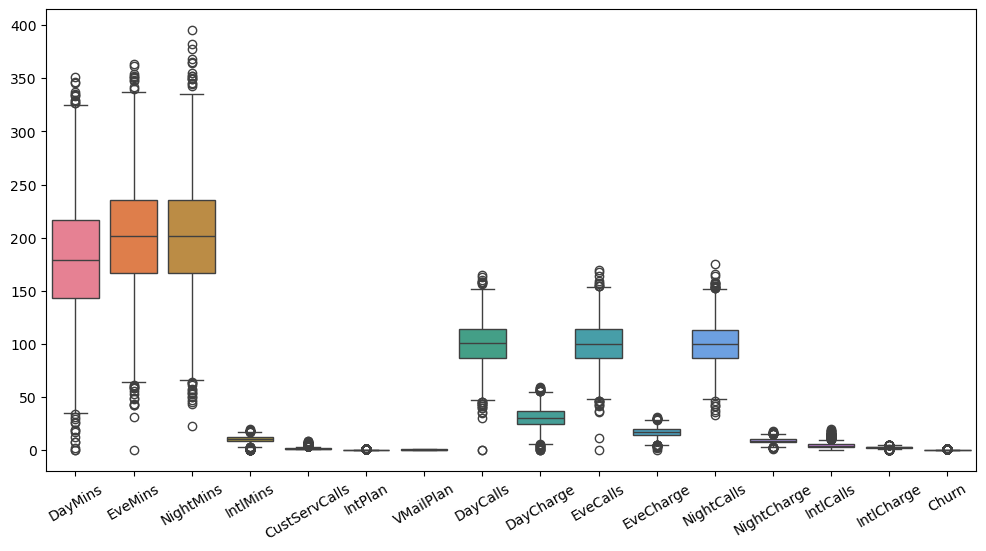

In [14]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=clean_data)
plt.xticks(rotation=30)
plt.show()

In [15]:
# prompt: normalize the clean_data using IQR with z-score by using sklearn

from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import RobustScaler

scaler = StandardScaler()
scaled_data = scaler.fit_transform(clean_data.drop('Churn', axis=1))

scaled_df = pd.DataFrame(scaled_data, columns=clean_data.columns[:-1])
scaled_df['Churn'] = clean_data['Churn']

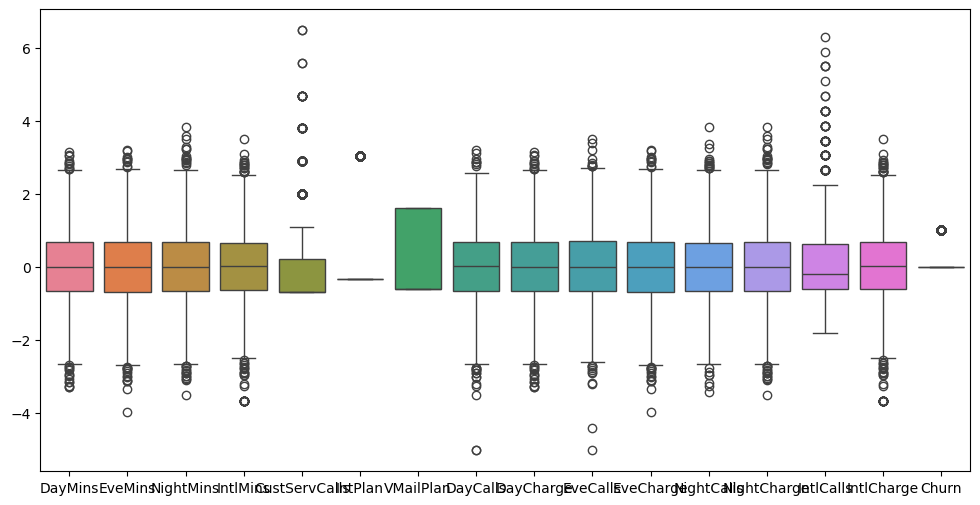

In [16]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=scaled_df)
plt.show()

In [17]:
# Train test split
X = scaled_df.drop(['Churn'], axis=1)
y=np.ravel(scaled_df['Churn'])
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state=50)
all_best_model = []

In [18]:
rf_model = RandomForestClassifier()
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
rf_best_model = grid_search.best_estimator_

y_pred = rf_best_model.predict(X_test)
report = classification_report(y_test, y_pred)
all_best_model.append(rf_best_model)

print(f"Best Parameters RandomForestClassifier: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters RandomForestClassifier: {'max_depth': None, 'min_samples_split': 10, 'n_estimators': 200}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.97       856
         1.0       0.95      0.72      0.82       144

    accuracy                           0.95      1000
   macro avg       0.95      0.86      0.90      1000
weighted avg       0.95      0.95      0.95      1000



In [19]:

lr_model =LogisticRegression(max_iter=50000)
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'solver': ['liblinear', 'saga']
}

grid_search = GridSearchCV(lr_model, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
lr_best_model = grid_search.best_estimator_

y_pred = lr_best_model.predict(X_test)
report = classification_report(y_test, y_pred)
all_best_model.append(lr_best_model)

print(f"Best Parameters LogisticRegression: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters LogisticRegression: {'C': 0.01, 'penalty': 'l2', 'solver': 'saga'}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.87      0.99      0.93       856
         1.0       0.71      0.15      0.25       144

    accuracy                           0.87      1000
   macro avg       0.79      0.57      0.59      1000
weighted avg       0.85      0.87      0.83      1000



In [20]:
dt_model = DecisionTreeClassifier()
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=dt_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
dt_best_model = grid_search.best_estimator_

y_pred = dt_best_model.predict(X_test)
report = classification_report(y_test, y_pred)
all_best_model.append(dt_best_model)

print(f"Best Parameters DecisionTreeClassifier: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters DecisionTreeClassifier: {'criterion': 'gini', 'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 10}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.95      0.98      0.96       856
         1.0       0.85      0.69      0.76       144

    accuracy                           0.94      1000
   macro avg       0.90      0.83      0.86      1000
weighted avg       0.93      0.94      0.93      1000



In [21]:

gb_model = GradientBoostingClassifier()
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=gb_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
gb_best_model = grid_search.best_estimator_
all_best_model.append(gb_best_model)

y_pred = gb_best_model.predict(X_test)
report = classification_report(y_test, y_pred)

print(f"Best Parameters GradientBoostingClassifier: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters GradientBoostingClassifier: {'learning_rate': 0.1, 'max_depth': 7, 'min_samples_split': 10, 'n_estimators': 200}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.98       856
         1.0       0.92      0.77      0.84       144

    accuracy                           0.96      1000
   macro avg       0.94      0.88      0.91      1000
weighted avg       0.96      0.96      0.96      1000



In [22]:

ab_model = AdaBoostClassifier()
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 1]
}

grid_search = GridSearchCV(estimator=ab_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
ab_best_model = grid_search.best_estimator_

y_pred = ab_best_model.predict(X_test)
report = classification_report(y_test, y_pred)
all_best_model.append(ab_best_model)

print(f"Best Parameters AdaBoostClassifier: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################



/home/jimmehehe/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/jimmehehe/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/jimmehehe/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/jimmehehe/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circum

Best Parameters AdaBoostClassifier: {'learning_rate': 1, 'n_estimators': 100}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.90      0.97      0.94       856
         1.0       0.70      0.38      0.49       144

    accuracy                           0.89      1000
   macro avg       0.80      0.68      0.71      1000
weighted avg       0.87      0.89      0.87      1000



In [23]:
svm_model = SVC()
param_grid = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto']
}

grid_search = GridSearchCV(estimator=svm_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
svm_best_model = grid_search.best_estimator_
all_best_model.append(svm_best_model)

y_pred = svm_best_model.predict(X_test)
report = classification_report(y_test, y_pred)

print(f"Best Parameters SVC: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters SVC: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.95      0.98      0.96       856
         1.0       0.87      0.66      0.75       144

    accuracy                           0.94      1000
   macro avg       0.91      0.82      0.86      1000
weighted avg       0.93      0.94      0.93      1000



In [24]:
knn_model = KNeighborsClassifier()
param_grid = {
    'n_neighbors': [3, 5, 7, 9],
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}

grid_search = GridSearchCV(estimator=knn_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
knn_best_model = grid_search.best_estimator_
all_best_model.append(knn_best_model)

y_pred = knn_best_model.predict(X_test)
report = classification_report(y_test, y_pred)

print(f"Best Parameters KNeighborsClassifier: {best_params}")
print(f"Classification Report:\n{report}")
#############################################################################################################

Best Parameters KNeighborsClassifier: {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'uniform'}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.92      0.99      0.95       856
         1.0       0.87      0.46      0.60       144

    accuracy                           0.91      1000
   macro avg       0.89      0.72      0.78      1000
weighted avg       0.91      0.91      0.90      1000



In [25]:

mlp_model = MLPClassifier(max_iter=5000)
param_grid = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50)],
    'activation': ['relu', 'tanh', 'logistic'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01]
}

grid_search = GridSearchCV(estimator=mlp_model, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
mlp_best_model = grid_search.best_estimator_
all_best_model.append(mlp_best_model)

y_pred = mlp_best_model.predict(X_test)
report = classification_report(y_test, y_pred)

print(f"Best Parameters MLPClassifier: {best_params}")
print(f"Classification Report:\n{report}")

Best Parameters MLPClassifier: {'activation': 'tanh', 'alpha': 0.001, 'hidden_layer_sizes': (50, 50), 'solver': 'sgd'}
Classification Report:
              precision    recall  f1-score   support

         0.0       0.94      0.99      0.96       856
         1.0       0.88      0.64      0.74       144

    accuracy                           0.94      1000
   macro avg       0.91      0.81      0.85      1000
weighted avg       0.93      0.94      0.93      1000



In [52]:
from sklearn.metrics import accuracy_score

### Select the best model

In [53]:
best_of_best = max(all_best_model, key=lambda model: accuracy_score(y_test, model.predict(X_test)))
print(best_of_best)
print(classification_report(y_test, best_of_best.predict(X_test)))

GradientBoostingClassifier(max_depth=7, min_samples_split=10, n_estimators=200)
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.98       856
         1.0       0.92      0.77      0.84       144

    accuracy                           0.96      1000
   macro avg       0.94      0.88      0.91      1000
weighted avg       0.96      0.96      0.96      1000



### Create a custom pipeline

In [54]:
my_pipline = Pipeline([
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('scaler', StandardScaler()),
    ('classifier', GradientBoostingClassifier(max_depth=7, min_samples_split=10, n_estimators=200))
])

In [ ]:
my_pipline.fit(X_train, y_train)

In [61]:
joblib.dump(my_pipline, 'myGBmodel.pkl')

['myGBmodel.pkl']

In [62]:
myGB = joblib.load('myGBmodel.pkl')

              precision    recall  f1-score   support

         0.0       0.96      0.99      0.98       856
         1.0       0.92      0.77      0.84       144

    accuracy                           0.96      1000
   macro avg       0.94      0.88      0.91      1000
weighted avg       0.96      0.96      0.96      1000



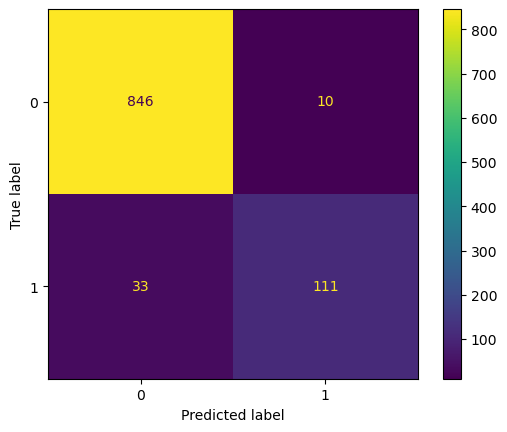

In [63]:
cm = confusion_matrix(y_test, myGB.predict(X_test))
print(classification_report(y_test, myGB.predict(X_test)))
ConfusionMatrixDisplay(cm).plot()